In [14]:
import scipy as scs
import scipy.io as sio
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from os import listdir
from os.path import isfile, join, isdir
import numpy as np
from PIL import Image
import cv2

### Training Videos

In [2]:
first_tr_vid = sio.loadmat('data/training_vol/vol01.mat')

In [3]:
first_tr_vid['vol'].shape

(120, 160, 1364)

In [11]:
first_tr_vid['vol'].shape[2]

1364

In [16]:
img1_vid1 = first_tr_vid['vol'][:,:,0]

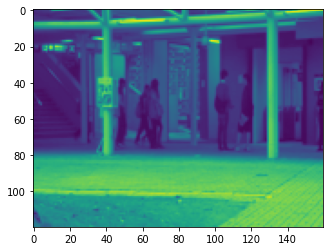

In [17]:
plt.imshow(img1_vid1)

In [18]:
img2_vid1 = first_tr_vid['vol'][:,:,1]

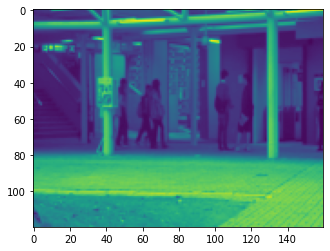

In [19]:
plt.imshow(img2_vid1)

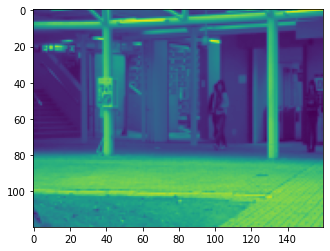

In [42]:
plt.imshow(img1360_vid1)

In [30]:
img1360_vid1 = first_tr_vid['vol'][:,:,1360]


In [39]:
res = cv2.resize(img1360_vid1, dsize=(128, 128), interpolation=cv2.INTER_CUBIC)

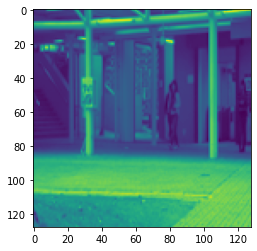

In [41]:
plt.imshow(res)

In [ ]:
def preprocess_image(image):  #Preprocessing image in color
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [128, 128])
    image /= 255.0  # normalize to [0,1] range
    return image.numpy()
    
def preprocess_image_gray(image): #Preprocessing image to gray scale
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [128, 128])
    image = np.ceil(0.2989 * image[:, :, 0] + 0.5870 * image[:, :, 1] + 0.1140 * image[:, :, 2])
    image /= 255.0
    return image

def load_and_preprocess_image(path):  # Loading and preprocessing color image 
    image = tf.io.read_file(path)
    return preprocess_image(image)

def load_and_preprocess_image_gray(path): # Loading and preprocessing gray image 
    image = tf.io.read_file(path)
    return preprocess_image_gray(image)


### Testing Videos

In [71]:
first_tst_vid = sio.loadmat('data/testing_vol/vol01.mat')

In [72]:
first_tst_vid['vol'].shape

(120, 160, 1439)

In [44]:
img1360_vid1 = first_tst_vid['vol'][:,:,1360]

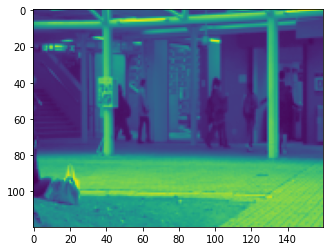

In [45]:
plt.imshow(img1360_vid1)

In [53]:
res = cv2.resize(img1360_vid1, dsize=(128, 128), interpolation=cv2.INTER_CUBIC)

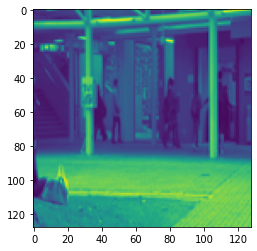

In [54]:
plt.imshow(res)

### Ground Truth Videos

In [97]:
first_tst_mask_vid = sio.loadmat('testing_label_mask/5_label.mat')

In [98]:
first_tst_mask_vid['volLabel'][0][0].shape

(360, 640)

In [99]:
img1360_vid1 = first_tst_mask_vid['volLabel'][0][1]

In [100]:
img1360_vid1.shape

(360, 640)

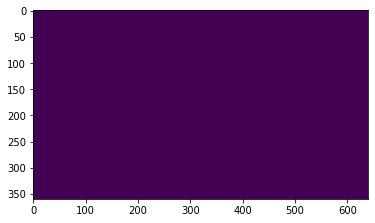

In [101]:
plt.imshow(img1360_vid1)

In [127]:
cap = cv2.VideoCapture('testing_videos/05.avi')


while not cap.isOpened():
    cap = cv2.VideoCapture("testing_videos/05.avi")
    cv2.waitKey(1000)
    print("Wait for the header")

pos_frame = cap.get(cv2.cv.CV_CAP_PROP_POS_FRAMES)
while True:
    flag, frame = cap.read()
    if flag:
        # The frame is ready and already captured
        cv2.imshow('video', frame)
        pos_frame = cap.get(cv2.cv.CV_CAP_PROP_POS_FRAMES)
        print(str(pos_frame)+" frames")
    else:
        # The next frame is not ready, so we try to read it again
        cap.set(cv2.cv.CV_CAP_PROP_POS_FRAMES, pos_frame-1)
        print("frame is not ready")
        # It is better to wait for a while for the next frame to be ready
        cv2.waitKey(1000)

    if cv2.waitKey(10) == 27:
        break
    if cap.get(cv2.cv.CV_CAP_PROP_POS_FRAMES) == cap.get(cv2.cv.CV_CAP_PROP_FRAME_COUNT):
        # If the number of captured frames is equal to the total number of frames,
        # we stop
        break

Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header
Wait for the header


KeyboardInterrupt: 

In [114]:
image

In [109]:
success,image = vidcap.read()
count = 0
while success:
    cv2.imwrite("frame%d.jpg" % count, image)     # save frame as JPEG file      
    success,image = vidcap.read()
    print('Read a new frame: ', success)
    count += 1

In [110]:
success

False

In [1]:
# import cv2
# import numpy as np

# res = cv2.resize(first_tr_vid['vol'], dsize=(128, 128), interpolation=cv2.INTER_CUBIC)

In [99]:
path = 'data/training_vol'
files = listdir(path)
#     keyword = 'vol'
frames = list()
for file in files:
    f = sio.loadmat(f'{path}/{file}')
    f_arr = f['vol']
    f_arr_ = np.resize(f_arr,(256,256))
    frames.append(f_arr_)
#     if isfile(file):
# #             f=open(os.path.join(your_path,file),'r')
#         f = sio.loadmat(f'{path}/{file}')


In [102]:
frames[0].shape

(256, 256)

In [98]:
clips[0].shape

(120, 160, 353)

In [73]:
test = np.array(clips)

In [78]:
len(clips)

18

In [51]:
for stride in range(1, 3):
    clips.extend(get_clips_by_stride(stride=stride, frames_list=frames, sequence_size=10))


In [40]:
len(clips)

16

In [34]:
f['vol'].shape

(120, 160, 1391)

In [14]:
from os import listdir
from os.path import isfile, join, isdir
import numpy as np
from PIL import Image

def get_clips_by_stride(stride, frames_list, sequence_size):
    """ For data augmenting purposes.
    Parameters
    ----------
    stride : int
        The distance between two consecutive frames
    frames_list : list
        A list of sorted frames of shape 256 X 256
    sequence_size: int
        The size of the lstm sequence
    Returns
    -------
    list
        A list of clips , 10 frames each
    """
    clips = []
    sz = len(frames_list)
    clip = np.zeros(shape=(sequence_size, 256, 256, 1))
    cnt = 0
    for start in range(0, stride):
        for i in range(start, sz, stride):
            clip[cnt, :, :, 0] = frames_list[i]
            cnt = cnt + 1
            if cnt == sequence_size:
                clips.append(clip)
                cnt = 0
    return clips

def get_training_set():
    """
    Returns
    -------
    list
        A list of training sequences of shape (NUMBER_OF_SEQUENCES,SINGLE_SEQUENCE_SIZE,FRAME_WIDTH,FRAME_HEIGHT,1)
    """
    clips = []
    # loop over the training folders (Train000,Train001,..)
    for filename in os.listdir('data/'):
        if filename.endswith(".mat"): 
            sio.loadmat('data/training_vol/')
    
    path = 'data/'
    files = os.listdir(path)
#     keyword = 'vol'
    for file in files:
        if os.path.isfile(file):
#             f=open(os.path.join(your_path,file),'r')
            f = sio.loadmat(os.path.join(path,file))
            for x in f:
                if keyword in x:
                    pass
            f.close()
        
#     for f in sorted(listdir(Config.DATASET_PATH)):
#         directory_path = join(Config.DATASET_PATH, f)
        if isdir(directory_path):
            all_frames = []
            # loop over all the images in the folder (0.tif,1.tif,..,199.tif)
            for c in sorted(listdir(directory_path)):
                img_path = join(directory_path, c)
                if str(img_path)[-3:] == "tif":
                    img = Image.open(img_path).resize((256, 256))
                    img = np.array(img, dtyp....e=np.float32) / 256.0
                    all_frames.append(img)
            # get the 10-frames sequences from the list of images after applying data augmentation
            for stride in range(1, 3):
                clips.extend(get_clips_by_stride(stride=stride, frames_list=all_frames, sequence_size=10))
    return clips